In [1]:
from data.dataset import REFLACXWithClinicalDataset
from model.xami import XAMIMultiModal, XAMIMultiCocatModal

from utils.gradcam import get_df_label_pred_img_input_loss, show_gradCAMpp_result

import torch
import os
import pandas as pd
from utils.train import get_aus_loss
import matplotlib.pylab as plt
from matplotlib.patches import Ellipse
import pandas as pd
from utils.plot import relabel_ellipse_df
from utils.transform import TransformFuncs
from copy import copy


In [2]:
pd.options.mode.chained_assignment = None

In [3]:
# checking if the GPU is available
use_gpu = torch.cuda.is_available()
device = 'cuda' if use_gpu else 'cpu'
print(f"Will be using {device}")

Will be using cuda


In [4]:
# load the dataset
reflacx_dataset = REFLACXWithClinicalDataset(image_size=256)

Positive Loss weight:
[0.768546   0.78635013 0.7937685  0.8338279  0.87388724]
Negative Loss weight:
[0.231454   0.21364985 0.20623146 0.1661721  0.12611276]
Random Loss:
0.21026036153991162


In [5]:
model_name = 'test_0_8260__epoch300_WithClincal_dim32_2022-02-08 10_03_56_953198'

In [6]:
# get the trained model
xami_mutlimodal = XAMIMultiCocatModal(
    reflacx_dataset,
    device,
    use_clinical=True,
    model_dim=32, # was 64
    embeding_dim=64,
    dropout=.2,  # increase the dropout rate did improve the regularization.
    pretrained=True
)
xami_mutlimodal.load_state_dict(torch.load(os.path.join('saved_models', model_name ), map_location=device))

xami_mutlimodal = xami_mutlimodal.to(device)
xami_mutlimodal.eval()


XAMIMultiCocatModal(
  (image_net): ImageDenseNet(
    (model_ft): DenseNet(
      (features): Sequential(
        (conv0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        (norm0): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu0): ReLU(inplace=True)
        (pool0): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
        (denseblock1): _DenseBlock(
          (denselayer1): _DenseLayer(
            (norm1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (relu1): ReLU(inplace=True)
            (conv1): Conv2d(64, 128, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (norm2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (relu2): ReLU(inplace=True)
            (conv2): Conv2d(128, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          )
          (denselayer

In [7]:
loss_fn = get_aus_loss(reflacx_dataset)

In [8]:
saving_folder = f'{model_name}_result'
os.makedirs(saving_folder, exist_ok=True)

In [9]:
def get_ellipses_patch(relabeled_ellipse_df, d, image_size_x, image_size_y, model_input_image_size):
    ellipses = []

    for _, instance in relabeled_ellipse_df[relabeled_ellipse_df[d]].iterrows():
        center_x = (instance['xmin'] + instance['xmax']) / 2
        center_y = (instance['ymin'] + instance['ymax']) / 2
        width = abs(instance['xmax'] - instance['xmin'])
        height = abs(instance['ymax'] - instance['ymin'])
        x_ratio = model_input_image_size / image_size_x
        y_ratio = model_input_image_size / image_size_y

        ellipses.append(Ellipse((center_x * x_ratio, center_y * y_ratio), width=width*x_ratio, height=height*y_ratio, edgecolor="red",facecolor="none", linewidth=2))

    return ellipses


C:\Users\mike8\AppData\Local\Temp\ipykernel_11276\2147771385.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, figsize=(10, 10), dpi=80, sharex=True)


KeyboardInterrupt: 

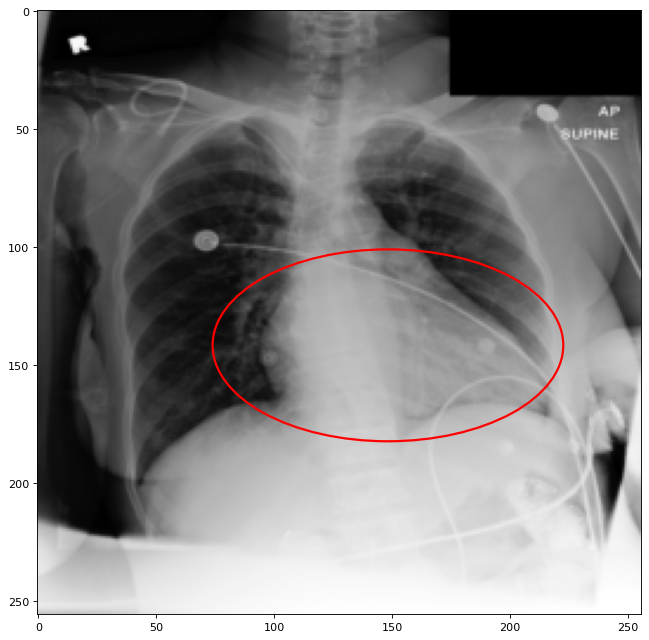

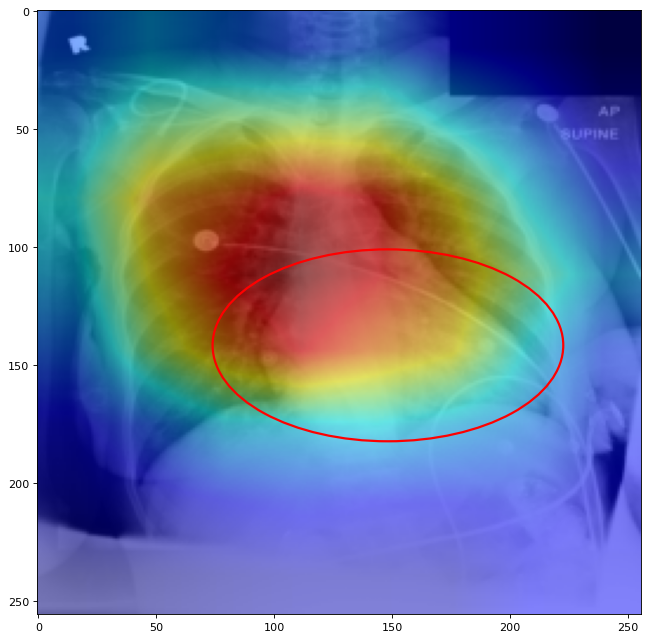

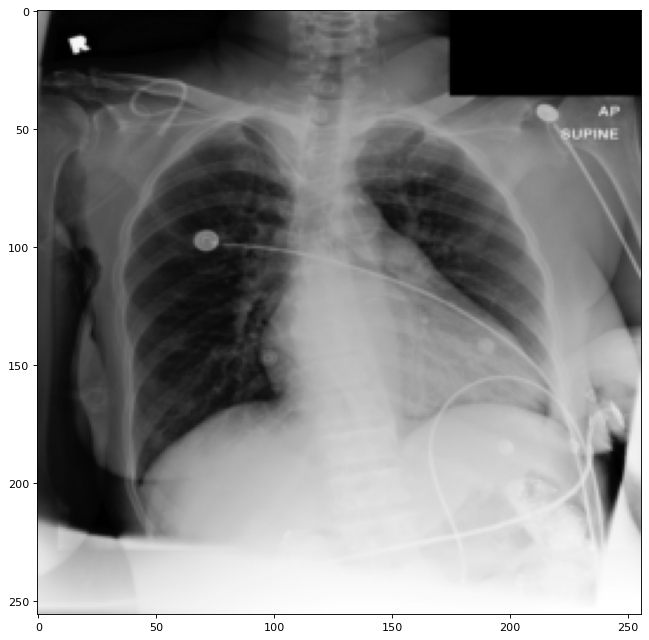

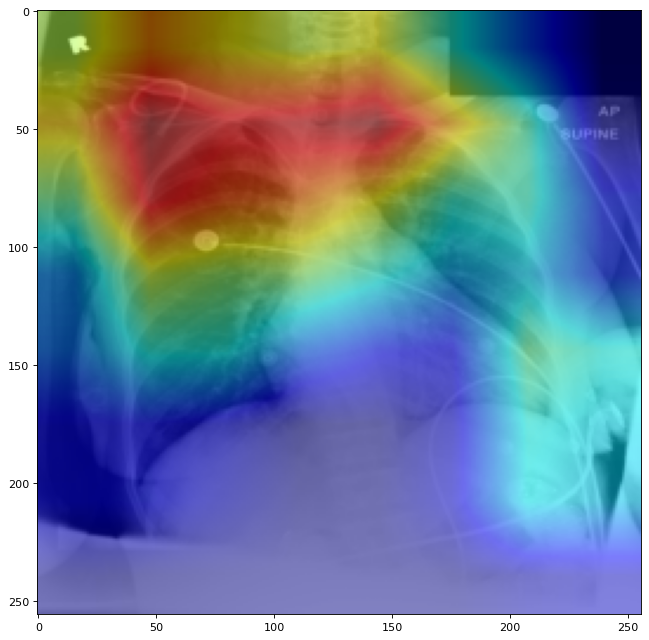

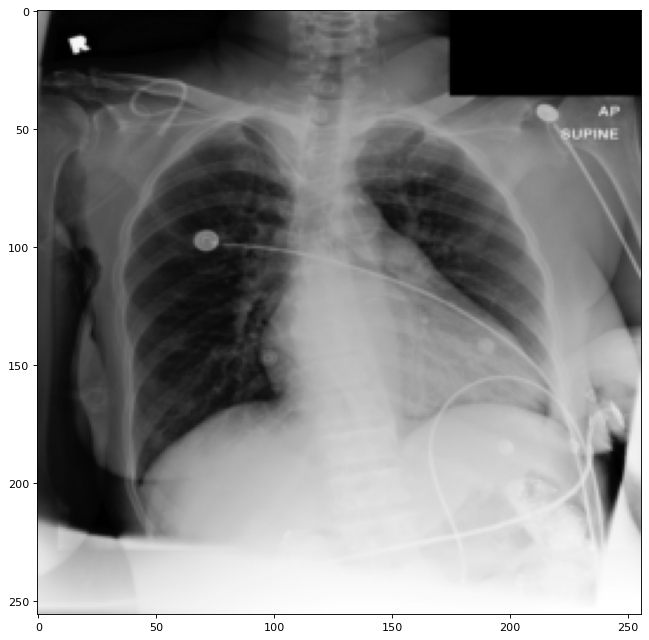

...

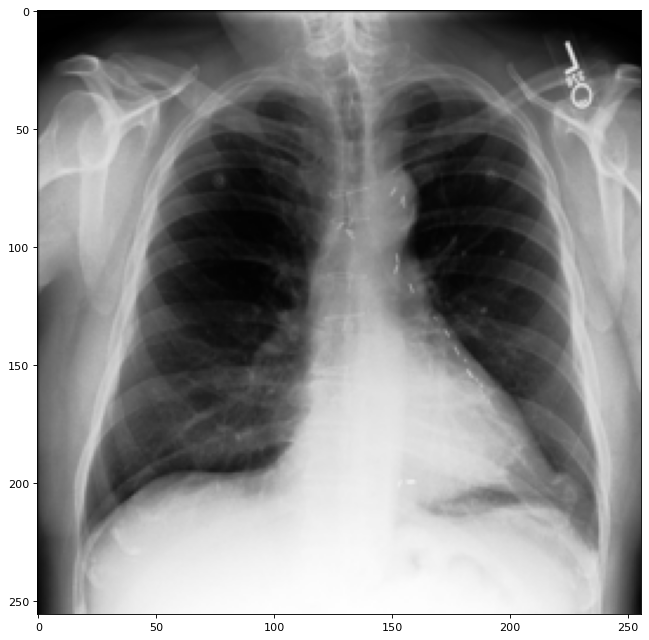

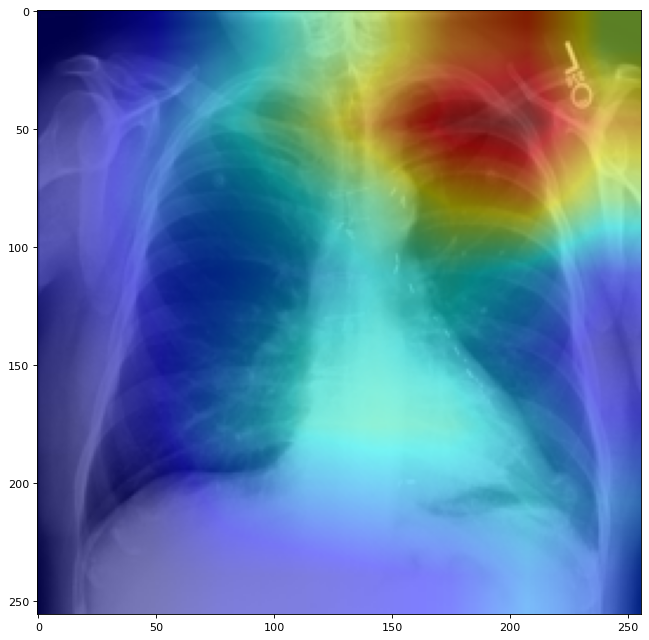

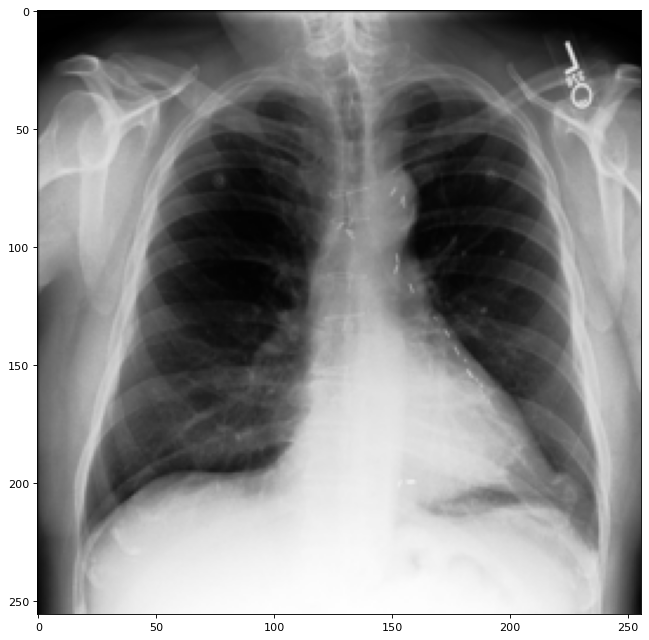

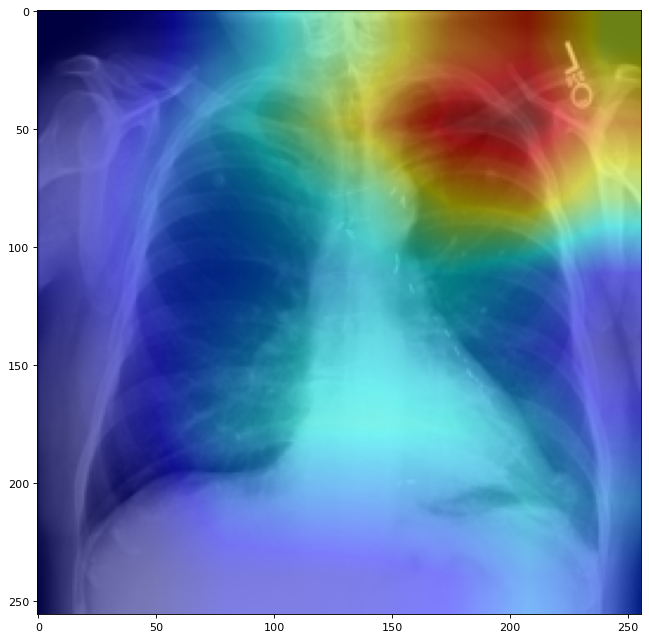

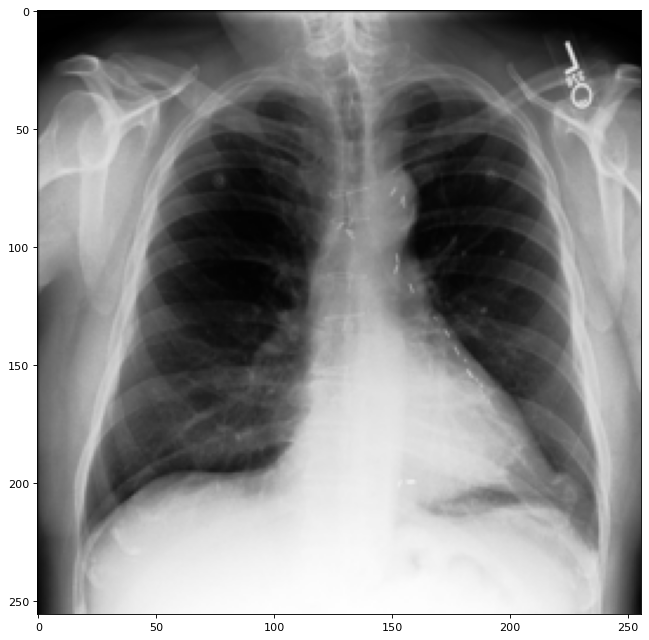

In [10]:
for i in range(len(reflacx_dataset)):

    df, labels_df, pred_df, img, loss, model_input = get_df_label_pred_img_input_loss(xami_mutlimodal, loss_fn, reflacx_dataset, i, device)

    instance_save_dir = os.path.join(saving_folder, df.iloc[0]['id'])
    os.makedirs(instance_save_dir, exist_ok=True)

    ellipse_df = pd.read_csv(df['anomaly_location_ellipses_path'].iloc[0])
    relabeled_ellipse_df = relabel_ellipse_df(ellipse_df)

    model_input_image_size = reflacx_dataset.image_size
    
    image_size_x = df.iloc[0]['image_size_x']
    image_size_y = df.iloc[0]['image_size_y']


    for d in reflacx_dataset.labels_cols:
        
        # instance = relabeled_ellipse_df[relabeled_ellipse_df[d]].iterrows()
        # center_x = (instance['xmin'] + instance['xmax']) / 2
        # center_y = (instance['ymin'] + instance['ymax']) / 2
        # width = abs(instance['xmax'] - instance['xmin'])
        # height = abs(instance['ymax'] - instance['ymin'])
        # x_ratio = model_input_image_size / image_size_x
        # y_ratio = model_input_image_size / image_size_y

        ## plot the original image with bouding boxes

        ellipes = get_ellipses_patch(relabeled_ellipse_df, d, image_size_x, image_size_y, model_input_image_size)

        fig, ax = plt.subplots(1, figsize=(10, 10), dpi=80, sharex=True)
        ax.imshow(TransformFuncs.display_transform(img))

        for e in ellipes:
            ax.add_patch(copy(e))

        fig.savefig(os.path.join(instance_save_dir, f'{d}_cxr_with_ellipse.png'))

        ## plot the gradcam images with bouding boxes.
        gradcam_img = show_gradCAMpp_result(reflacx_dataset, xami_mutlimodal, d, img, model_input, use_full_features=True)

        fig, ax = plt.subplots(1, figsize=(10, 10), dpi=80, sharex=True)
        ax.imshow(gradcam_img)
        fig.savefig(os.path.join(instance_save_dir, f'{d}_cxr_gradcampp.png'))

        for e in ellipes:
            ax.add_patch(copy(e))

        fig.savefig(os.path.join(instance_save_dir, f'{d}cxr_gradcampp_with_ellipse.png'))

    ## store prediction data and loss as well.
    for l_col in reflacx_dataset.labels_cols:
        df[f"pred_{l_col}"] = None
        df.at[0, f"pred_{l_col}"] = pred_df.at[0, l_col]

    df.at[0, 'loss'] = loss

    df.to_csv(os.path.join(instance_save_dir, "df.csv"))


In [ ]:
# loss_fn = get_aus_loss(reflacx_dataset)

In [ ]:
# df, labels_df, pred_df, img, loss, model_input = get_df_label_pred_img_input_loss(xami_mutlimodal, loss_fn, reflacx_dataset, test_instance_idx, device)

# display(img)
# display(df)
# display(labels_df)
# display(pred_df)

In [ ]:
TransformFuncs.display_transform(img)

In [ ]:
relabeled_ellipse_df.iloc[1]

In [ ]:
disease = 'Atelectasis'

instance = relabeled_ellipse_df[relabeled_ellipse_df[disease]].iloc[0]

center_x = (instance['xmin'] + instance['xmax']) / 2
center_y = (instance['ymin'] + instance['ymax']) / 2
width = abs(instance['xmax'] - instance['xmin'])
height = abs(instance['ymax'] - instance['ymin'])

In [ ]:
fig, ax = plt.subplots(1, figsize=(10, 10), dpi=80, sharex=True)
ax.imshow(img)
ax.add_patch(Ellipse((center_x, center_y), width=width, height=height, edgecolor="red",facecolor="none", linewidth=1))

In [ ]:
gradcam_img = show_gradCAMpp_result(reflacx_dataset, xami_mutlimodal, disease, img, model_input, use_full_features=True)

fig, ax = plt.subplots(1, figsize=(10, 10), dpi=80, sharex=True)
ax.imshow(gradcam_img)


x_ratio = model_input_image_size / image_size_x
y_ratio = model_input_image_size / image_size_y

ax.add_patch(Ellipse((center_x * x_ratio, center_y * y_ratio), width=width*x_ratio, height=height*y_ratio, edgecolor="red",facecolor="none", linewidth=2))